# UK Property Image Classification
### EDA model 7d

---

In [1]:
model_tag = "model7d"
label = "ext"  # new (period vs modern), or ext (interior vs exterior)

root = "../"
min_size = 300

#### Data:
- Ensure unique, non-repetitive image based on hash values
- Classification of exterior vs interior photos, 500 images each class
- Using both period and modern buildings

#### Model:
Convoluted Neural Nets
- Use standard scaler
- Use early stopper based on max auc
- Use dropout
- AUC as metrics
- Pooling Filter 9x9
- Epoch = 60 max

#### Model results:
- AUC = [ ]%, Accuracy = [ ]% (baseline at 50%)

### Importing libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import re
from math import ceil
import random

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

from skimage import io
from skimage import color
from skimage.transform import rescale, resize

import pickle

In [3]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.metrics import AUC
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier

In [4]:
# For reproducibility
np.random.seed(42)

In [5]:
import sys
sys.path.insert(0, '../common')
from myfunctions import *

#### Load the training data - interior images

In [6]:
#default csv file of image record
file = root + 'data/images_train_val.csv'

# ext = 0 refers to the interior images
# repeated = 1 refers to the first images ie not a duplicate
criteria = {"ext":0., "repeated":1}

k = 500

# dataframe of labels = 0
df_selected0 = load_train_val(file, criteria, k)

In [7]:
print(df_selected0.shape)
df_selected0.head()

(500, 5)


,image_link,hash,repeated,ext,new
index,,,,,
1662,../images/old_more/photo-14677457-QUkOBW.jpg,ff7f3fff0164e660,1,0,1
2008,../images/old_more/photo-14716542-HLYPgh.jpg,7f7ffcfc7c003030,1,0,0
967,../images/modern_more/photo-14715008-CM1V3P.jpg,3f1fcfef83018fcf,1,0,1
421,../images/modern_more/photo-14658419-LaCU9c.jpg,fffffcfcccc40000,1,0,0
812,../images/modern_more/photo-14704524-r4KkVg.jpg,fefe757dff0f0c0c,1,0,1


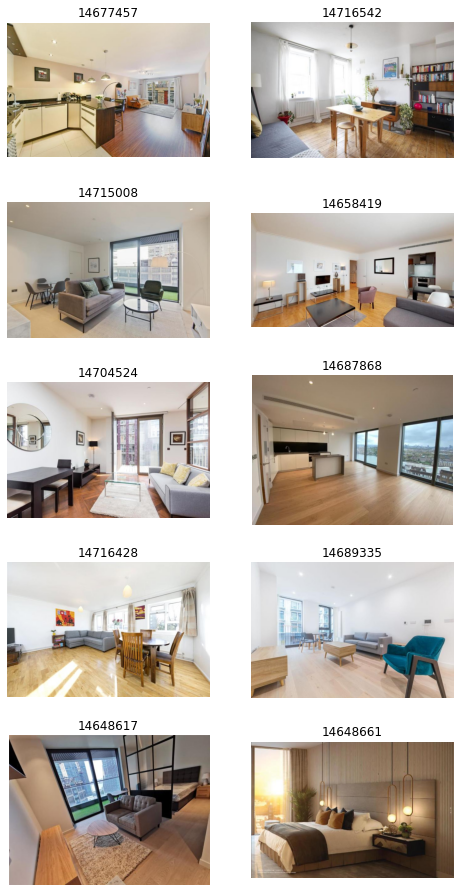

In [8]:
display_no = 10
df_file_info = df_selected0

display_images(display_no, df_file_info)

#### Load the training data - exterior images

In [9]:
#default csv file of image record
file = root + 'data/images_train_val.csv'

# ext = 1 refers to the exterior images
# repeated = 1 refers to the first images ie not a duplicate
criteria = {"ext":1., "repeated":1}

k = 500

# dataframe of labels = 1
df_selected1 = load_train_val(file, criteria, k)

In [10]:
print(df_selected1.shape)
df_selected1.head()

(500, 5)


,image_link,hash,repeated,ext,new
index,,,,,
1104,../images/modern_more/photo-14722704-KpN6eL.jpg,ffbffffede0240c2,1,1,1
2095,../images/old_samples/photo-14629754-mieGul.jpg,ffff0300081200ff,1,1,0
1806,../images/old_more/photo-14697626-e1RUI5.jpg,fffffffda10000c0,1,1,0
1805,../images/old_more/photo-14697620-btJMNo.jpg,fffbeecff8181030,1,1,0
1093,../images/modern_more/photo-14721790-mO8608.jpg,e7e7e7e7e6420000,1,1,1


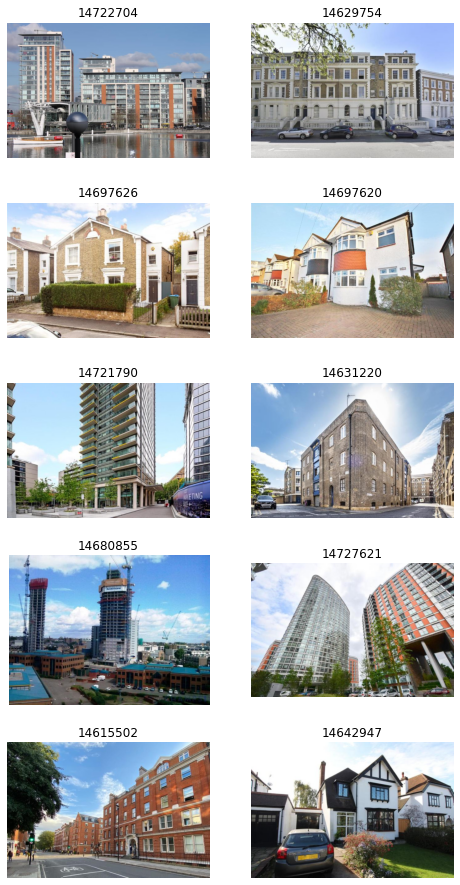

In [11]:
display_no = 10
df_file_info = df_selected1

display_images(display_no, df_file_info)

#### Loading training data into dataframe

In [12]:
# consolidating files of labels 0 and 1
df_all = pd.concat([df_selected0, df_selected1])
df_all.reset_index(drop=True, inplace=True)
df_all["id"] = df_all.index

# loading images into array
X = load_array(df_all["image_link"], min_size)

c:\python37\lib\site-packages\PIL\TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))


In [13]:
# recording relevant link and labels
df_y = df_all[["id", "image_link", label]]
df_y.rename(columns={label:"label"}, inplace=True)

print(df_y.shape)
df_y.head(5)

(1000, 3)


c:\python37\lib\site-packages\pandas\core\frame.py:4303: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,id,image_link,label
0,0,../images/old_more/photo-14677457-QUkOBW.jpg,0
1,1,../images/old_more/photo-14716542-HLYPgh.jpg,0
2,2,../images/modern_more/photo-14715008-CM1V3P.jpg,0
3,3,../images/modern_more/photo-14658419-LaCU9c.jpg,0
4,4,../images/modern_more/photo-14704524-r4KkVg.jpg,0


#### Train test split

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X, df_y, stratify=df_y["label"])
print(y_train.shape)

(750, 3)


In [15]:
# Baseline accuracy - 50%
y_train['label'].value_counts()

1    375
0    375
Name: label, dtype: int64

In [16]:
y_test.shape

(250, 3)

In [17]:
y_test['id'][:10]

205    205
191    191
105    105
166    166
14      14
71      71
600    600
273    273
992    992
216    216
Name: id, dtype: int64

#### Check if the first row of X_train and y_train refer to the same image

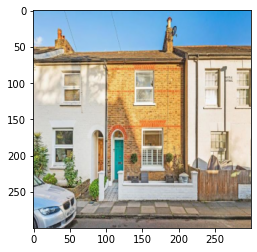

In [18]:
plt.imshow(X_train[0])

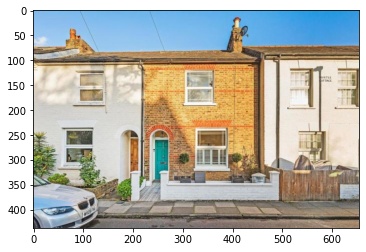

In [19]:
plt.imshow(io.imread(y_train.iloc[0,1]))

#### Standard Scaler

In [20]:
ss, X_train_ss = image_std_train(X_train)

(750, 270000)
(750, 300, 300, 3)


In [21]:
X_test_ss = image_std_test(X_test, ss)

### CNN model

In [22]:
# function to create a keras CNN model based on parameters
# Variables to be declared:
# min_size: photos will be resized to squares with such number of pixels each size: 300, 400
# pool_size: 3, 5, 7, 9, 11
# dropout: 0.5, 0.7
# dense_layer_neurons: 64, 128

def create_model(min_size, pool_size, dense_layer_neurons, dropout):
    model = Sequential()
    model.add(Conv2D(filters = 6,            # number of filters
                         kernel_size = 3,        # height/width of filter
                         activation='relu',      # activation function 
                         input_shape=(min_size,min_size,3))) # shape of input (image)
    model.add(MaxPooling2D(pool_size=(pool_size,pool_size))) # dimensions of region of pooling
    model.add(Conv2D(16, kernel_size=3, activation='relu'))
    model.add(MaxPooling2D(pool_size=(pool_size,pool_size)))
    model.add(Flatten())
    model.add(Dense(dense_layer_neurons, activation='relu'))
    model.add(Dropout(dropout))
    # Add a final layer with 1 neuron
    model.add(Dense(1, activation='sigmoid'))

    # Compile model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=["accuracy"])
    
    print(model.summary())
    
    return model

In [23]:
# Early stopping
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5)
# GridCVSearch parameters
parameters = {"min_size":[300], "pool_size":[9,11], "dense_layer_neurons":[256], "dropout":[0.5]}

In [24]:
model = KerasClassifier(build_fn=create_model, verbose=0)
grid = GridSearchCV(estimator=model, param_grid=parameters, n_jobs=1, cv=2)
grid_result = grid.fit(X_train_ss,
                        y_train['label'],
                        batch_size=20,
                        validation_data=(X_test_ss, y_test['label']),
                        epochs=10,
                        callbacks=[es],
                        verbose=1)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 298, 298, 6)       168       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 33, 33, 6)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 31, 31, 16)        880       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 3, 3, 16)          0         
_________________________________________________________________
flatten (Flatten)            (None, 144)               0         
_________________________________________________________________
dense (Dense)                (None, 256)               37120     
_________________________________________________________________
dropout (Dropout)            (None, 256)               0

Epoch 9/10
19/19 [==============================] - 6s 316ms/step - loss: 0.1921 - accuracy: 0.9347 - val_loss: 0.1443 - val_accuracy: 0.9520
Epoch 10/10
19/19 [==============================] - 6s 307ms/step - loss: 0.1904 - accuracy: 0.9412 - val_loss: 0.1348 - val_accuracy: 0.9560
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 298, 298, 6)       168       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 27, 27, 6)         0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 25, 25, 16)        880       
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 2, 2, 16)          0         
_________________________________________________________________
flatten_3 (Flatten)          (Non

In [25]:
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.961333 using {'dense_layer_neurons': 256, 'dropout': 0.5, 'min_size': 300, 'pool_size': 9}
0.961333 (0.001333) with: {'dense_layer_neurons': 256, 'dropout': 0.5, 'min_size': 300, 'pool_size': 9}
0.944000 (0.010667) with: {'dense_layer_neurons': 256, 'dropout': 0.5, 'min_size': 300, 'pool_size': 11}


In [26]:
# fitting the model with the best params

print(grid_result.best_params_)
model = create_model(**grid_result.best_params_)
history = model.fit(X_train_ss,
                        y_train['label'],
                        batch_size=20,
                        validation_data=(X_test_ss, y_test['label']),
                        epochs=10,
                        callbacks=[es],
                        verbose=1)

{'dense_layer_neurons': 256, 'dropout': 0.5, 'min_size': 300, 'pool_size': 9}
Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 298, 298, 6)       168       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 33, 33, 6)         0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 31, 31, 16)        880       
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 3, 3, 16)          0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 144)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 256)               37120     
__________________________________________

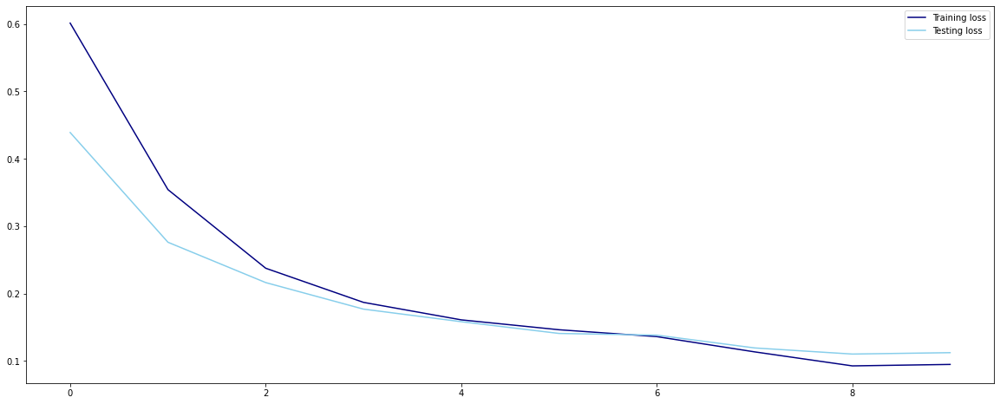

In [27]:
# plot the changes in loss function values
train_loss = history.history['loss']
test_loss = history.history['val_loss']
plt.figure(figsize=(20, 8))
plt.plot(train_loss, label='Training loss', color='navy')
plt.plot(test_loss, label='Testing loss', color='skyblue')
plt.legend();

#### Predictions based on the model

In [28]:
y_pred = model.predict(X_test_ss)

In [29]:
y_pred.shape

(250, 1)

#### Area under Curve

In [30]:
fpr_keras, tpr_keras, thresholds_keras = roc_curve(y_test["label"], y_pred)
auc_keras = auc(fpr_keras, tpr_keras)

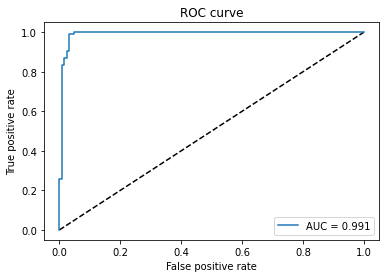

In [31]:
plt.figure(1)
plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr_keras, tpr_keras, label='AUC = {:.3f}'.format(auc_keras))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best')
plt.show()

#### List out the images of misclassification - test images

In [32]:
y_test['pred'] = y_pred.round()
y_test['prob'] = y_pred.round(2)
y_test.head(10)

c:\python37\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
c:\python37\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,id,image_link,label,pred,prob
205,205,../images/old_interior/photo-14639321-eEPmK9.jpg,0,0.0,0.01
191,191,../images/modern_more/photo-14654687-eqfDv3.jpg,0,0.0,0.00
105,105,../images/modern_samples/photo-14612747-f409k4...,0,0.0,0.00
166,166,../images/old_more/photo-14680888-W596MD.jpg,0,0.0,0.01
14,14,../images/modern_more/photo-14655707-sDj6wY.jpg,0,0.0,0.00
71,71,../images/old_interior/photo-14639999-3bqJ5b.jpg,0,0.0,0.00
600,600,../images/old_more/photo-14638999-IIeQmp.jpg,1,1.0,0.85
273,273,../images/old_interior/photo-14621810-geIdub.jpg,0,0.0,0.01
992,992,../images/modern_exterior/photo-14731277-FdThT...,1,1.0,0.86
216,216,../images/old_more/photo-14712524-gZAwxI.jpg,0,0.0,0.01


#### Images properly classified

In [33]:
# count the number of photos classified properly in y_test
y_test_classified = y_test[["image_link", "label", "pred", "prob"]][y_test["label"] == y_test["pred"]]

print(f"total number in y_test: {y_test.shape[0]}")
print(f"classified properly in y_test: {y_test_classified.shape[0]}")
y_test_classified.head()

print(f"accuracy: {round(y_test_classified.shape[0]/y_test.shape[0],2)}")

total number in y_test: 250
classified properly in y_test: 238
accuracy: 0.95


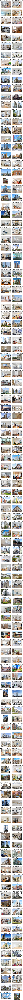

In [40]:
# show the first 20 photos classified properly in y_test
display_no = y_test_classified.shape[0]
df_file_info = y_test_classified

display_predictions(display_no, df_file_info)

#### Images misclassified

In [35]:
# count the number of photos misclassified in y_test
y_test_misclassified = y_test[["image_link", "label", "pred", "prob"]][y_test["label"] != y_test["pred"]]

print(f"total number in y_test: {y_test.shape[0]}")
print(f"misclassified in y_test: {y_test_misclassified.shape[0]}")
y_test_misclassified.head()

total number in y_test: 250
misclassified in y_test: 12


,image_link,label,pred,prob
315,../images/modern_more/photo-14665126-ZJL7o5.jpg,0,1.0,1.00
723,../images/old_samples/photo-14719393-lHS9VZ.jpg,1,0.0,0.31
813,../images/modern_more/photo-14709186-FFtyXn.jpg,1,0.0,0.22
419,../images/modern_more/photo-14669921-o65fPy.jpg,0,1.0,0.86
722,../images/modern_exterior/photo-14725338-m4hvg...,1,0.0,0.27


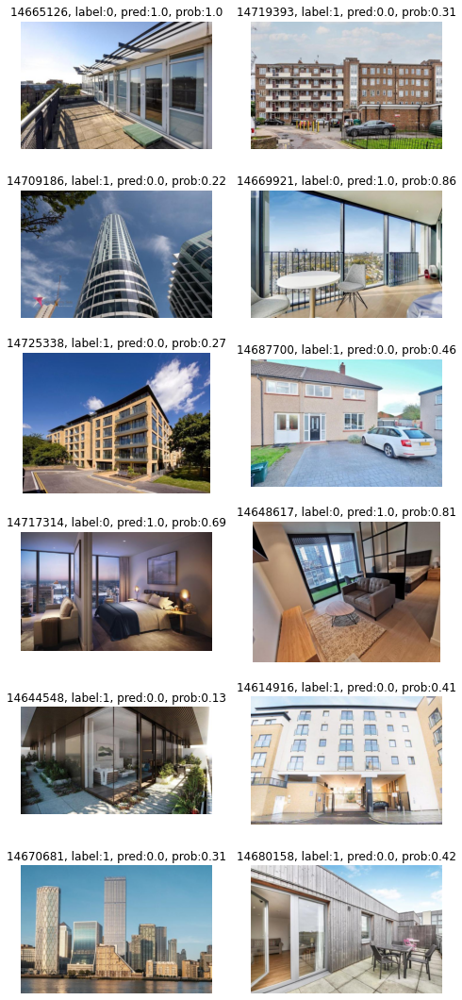

In [36]:
# show the first 20 photos misclassified in y_test

display_no = y_test_misclassified.shape[0]
df_file_info = y_test_misclassified

display_predictions(display_no, df_file_info)

#### Correctly classified as Interior

c:\python37\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


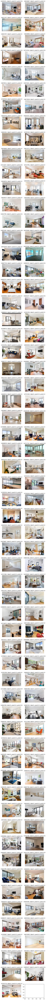

In [42]:
# Correctly classified as 0
y_test_classified0 = y_test[["image_link", "label", "pred", "prob"]][y_test["label"] == y_test["pred"]][y_test["label"]==0]

display_no = y_test_classified0.shape[0]
df_file_info = y_test_classified0

display_predictions(display_no, df_file_info)

#### Correctly classified as Exterior

c:\python37\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


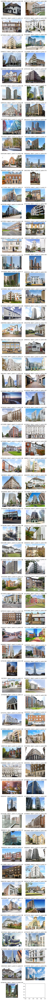

In [41]:
# Correctly classified as 1
y_test_classified1 = y_test[["image_link", "label", "pred", "prob"]][y_test["label"] == y_test["pred"]][y_test["label"]==1]

display_no = y_test_classified1.shape[0]
df_file_info = y_test_classified1

display_predictions(display_no, df_file_info)

### Saving the model

In [37]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 298, 298, 6)       168       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 33, 33, 6)         0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 31, 31, 16)        880       
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 3, 3, 16)          0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 144)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 256)               37120     
_________________________________________________________________
dropout_5 (Dropout)          (None, 256)              

In [38]:
# Save the model
path = '../models/' + model_tag + '/'
model.save(path)


INFO:tensorflow:Assets written to: ../models/model7d/assets


In [39]:
# save the scaler
pickle.dump(ss, open('../models/' + model_tag + '/scaler.pkl', 'wb'))